# Importing the modules

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib

# Getting and Cleaning the Data

## Importing the data

In [2]:
df=pd.read_csv("ipl_matches.csv", usecols=[3,10])
df.dropna(inplace=True)

## Renaming and getting the abbreviations

In [3]:
df.replace({"Delhi Daredevils":"Delhi Capitals","Rising Pune Supergiant":"Rising Pune Supergiants"}, inplace=True)
d={}; di={}
for s in df["winner"].unique():
    d[s]="".join([i[0] for i in s.split()])
d["Sunrisers Hyderabad"]="SRH"; d["Kings XI Punjab"]="KXIP"; d["Deccan Chargers"]="DCH" #Changing the exceptions
for i in d:
    di[d[i]]=i
df["winner"]=df["winner"].apply(lambda x: d[x])

## Colors

In [4]:
colors=dict(zip(d.values(), ["orangered", "#d11d9b", "#2e0854", "darkgrey", "#ec1c24", "#0e74e8", "deeppink", "#e04f16", "#e3c612", "#004ba0", "#d9e3ef", "#c0d6eb", "#ec1c24","#632b72"]))

## Converting to DateTime

#### Pandas to Datetime is not useful as the dates are in different formats which getsrecognized incorrectly.

In [5]:
def datetimeconverter(s):
    if "-" in s:
        return datetime.datetime.strptime(s,"%Y-%m-%d")
    return datetime.datetime.strptime(s, "%d/%m/%y")

df["date"]=df["date"].apply(datetimeconverter)
df.sort_values("date", inplace = True)
df["date"]=df["date"].apply(lambda x: x.strftime("%d %b %Y"))
ind=df["date"].values #The value of the dates

## Creating Data for Each Date

In [6]:
df1=pd.get_dummies(df['winner']).cumsum() #Get the other teams wins as a dataframe with the team as column

df=pd.concat([df, df1], axis=1).drop_duplicates(subset=["date"], keep="last") #Joining the dataframes and dropping the duplicate dates (when 2 matches happened on the ame date)

df.set_index("date", inplace=True) #Setting the index as the date.

df.drop(columns="winner", inplace=True)

In [7]:
def get_data_for_date(date):
    s=df.loc[date].nlargest()[::-1]
    return s

# Plotting this Data

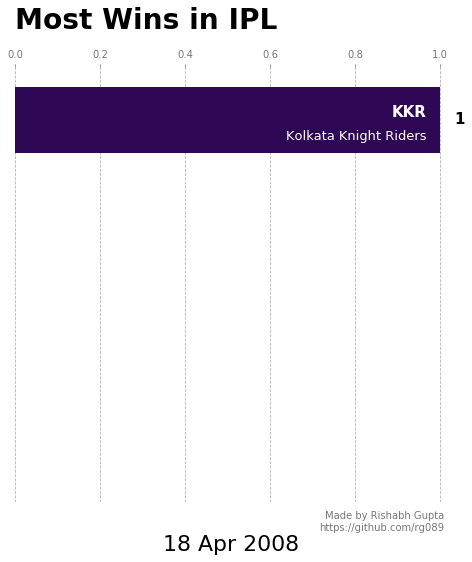

In [8]:
def plotting(date):
    x=get_data_for_date(date)
    plt.clf()
    ax=plt.gca()
    fig=plt.gcf()
    plt.barh(x.index, x.values, color=[colors[i] for i in x.index])
    plt.box(False)
    ax.xaxis.set_ticks_position('top')
    ax.set_axisbelow(True)
    plt.yticks([])
    ax.tick_params(axis='x', colors='#777777', labelsize=10)
    ax.grid(which='major', axis='x', linestyle='--')
    for i in range(len(x.index)):
        if x.values[i]==0:
            continue
        dx=x.values[i]/30
        plt.text(x.values[i]-dx, i, x.index[i], ha="right", size=15, weight=900, va="bottom", color="white")
        plt.text(x.values[i]+dx, i, x.values[i], ha="left", size=15, weight=560, va="center")
        plt.text(x.values[i]-dx, i-0.25, di[x.index[i]], ha="right", size=13, weight=350, va="baseline", color="snow")
    ax.text(0, 5.1, 'Most Wins in IPL', size=28, weight=600, ha='left')
    fig.text(0.5, 0.04, date, size=22, ha="center")
    fig.text(0.87, 0.096, "Made by Rishabh Gupta", ha="right", c="#777777")
    fig.text(0.87, 0.075, "https://github.com/rg089", ha="right", c="#777777")
    

fig=plt.figure(figsize=(8,8))
matplotlib.rcParams['animation.embed_limit'] = 40 #Setting the size to 40 MB
animator = animation.FuncAnimation(fig, plotting, frames=ind, interval=55)
HTML(animator.to_jshtml())